### María Sofía Álvarez López, Brenda Catalina Barahona Pinilla, Alvaro Daniel Plata Marquez
<h1 align='center'>Laboratorio 4 - Inteligencia de Negocios: Regresiones</h1>

La Clínica de los Alpes desea conocer cuales son los principales factores de muerte que disminuyen la expectativa de vida de los ciudadanos de su país para realizar campañas de concientización con el fin de mejorar la calidad de vida de los ciudadanos.

La Clínica cuenta con un conjunto de datos sobre las expectativas de vida a lo largo de los años en los Alpes y países cercanos, junto con algunos indicadores que miden la salud de una persona, como lo puede ser el índice de masa corporal, la incidencia de varias enfermedades y algunos factores socioculturales como el consumo de alcohol o tabaco.

Esta información quieren utilizarla para construir un modelo que les pueda ayudar para resolver las siguientes tareas:

* Identificar las variables que más impactan en la expectativa de vida de la gente de los Alpes.
* Predecir la expectativa de vida en los Alpes a partir de las variables de interés.

### Nota importante
Para este laboratorio, usamos algunas transformaciones personalizadas en el pipeline, como se verá más adelante. Asimismo, tomamos únicamente el modelo que nos dio los mejores resultados en el laboratorio pasado (laboratorio 3).

In [1]:
#ESAI
import os
import pickle
import cloudpickle
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.stats as stats
import statsmodels.api as sm
from joblib import dump, load
import matplotlib.pyplot as plt
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from pandas_profiling import ProfileReport
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error as mse
from sklearn.feature_selection import SelectKBest, chi2, VarianceThreshold
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
###
from clases import columnDropperTransformer, columnZeroToNaNTransformer, outOfRangeTransformer

In [2]:
%matplotlib inline

Vemos que la clínica nos está pidiendo dos cosas. Primero, para identificar las variables que más impactan en la expectativa de vida de la gente de los Alpes, es necesario realizar tests como t-student con el fin de entender cuáles son las variables de mayor impacto en la variable objetivo: la expectativa de vida. Segundo, con dichas variables, usando un modelo de regresión lineal, es posible predecir la expectativa de vida en los Alpes. Antes de realizar estas tareas, entendamos los datos suministrados por el negocio.
## 1. Entendimiento de los datos
Lo primero que hacemos es entender las características de los datos suministrados y el análisis de calidad de ellos:

In [3]:
datos = pd.read_csv('DatosTrain.csv')
data = datos.copy()

Una vez leídos los datos, podemos ver la cantidad de columnas (features) y datos (filas) que tiene nuestro conjunto de datos:

In [4]:
datos.shape

(2644, 20)

En principio, nuestro conjunto de datos cuenta con 2644 registros y 20 columnas. Veamos una muestra aleatoria de 5 datos del dataset:

In [5]:
datos.sample(5)

,Unnamed: 0,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 10-19 years,thinness 5-9 years,Income composition of resources,Schooling
2575,2575,73.7,16.0,11,5.88,547.210141,98.0,6071,26.8,12,99.0,4.11,99.0,0.3,4212.549200,66881867.0,8.3,8.5,0.706,13.0
2095,2095,79.8,77.0,2,9.05,0.000000,91.0,194,28.2,2,91.0,5.99,91.0,0.1,0.000000,0.0,1.5,1.0,0.000,0.0
1103,1103,52.8,35.0,5,2.47,24.657618,0.0,298,18.5,8,61.0,5.84,57.0,4.1,321.481324,1293523.0,9.8,9.7,0.000,7.1
956,956,65.0,37.0,2,7.72,353.243803,28.0,0,3.8,3,44.0,2.76,45.0,10.9,6741.293948,143126.0,7.2,7.1,0.640,12.4
342,342,59.2,393.0,2,5.01,426.785566,94.0,184,34.7,3,96.0,6.39,96.0,9.0,5185.729845,1979882.0,8.4,8.2,0.661,12.2


De acuerdo con el enunciado, tenemos que los Alpes nos ha dado la expectativa de vida en los Alpes y otros países cercanos a lo largo de los años. A priori, podemos ver que hay una columna Unnamed:0 que es el equivalente a un ID. Esta puede ser posteriormente eliminada. Para un análisis máse exhaustivo de las variables, procedemos a hacer el reporte del ```pandas_profiling```:




In [6]:
profiling = ProfileReport(datos)
profiling.to_file(output_file="pandas_profiling.html")
profiling

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Lo primero que vemos es que el conjunto de datos NO cuenta con valores nulas (la cantidad de celdas faltantes es 0), ni tampoco con filas duplicadas. Esto da un primer buen indicio de la calidad de los datos. Exploremos ahora, columna por columna, cada una de las variables del problema:
* **Unnamed: 0:** Es una especie de ID y no es fundamental para el problema ni el algoritmo de Machine Learning. Debe ser eliminada para el análisis.
* **Life expectancy:** Variable numérica que representa la expectativa de vida del país en años. Vemos que hay 9 valores en 0, lo cual es raro porque ningún país debe tener esta expectativa de vida. Intuimos que son valores nulos que marcaron como 0. Tiene un máximo de 89 años y una media de 69. Sin contar los ceros, los datos se encuentran en un rango adecuado.
* **Adult Mortality:** Tasa de mortalidad en personas entre 15 y 60 años de edad medida en muertes por cada 1000 habitantes. La tasa tiene un rango entre 0 y 699. No obstante, el rango es extraño: en el peor de los casos es 699, lo cual tiene sentido, pero no puede haber un país en que no haya por lo menos un muerto entre 15 y 60 años (según nuestros análisis, estudios y consultas a expertos). Vemos que la media de muertes por cada 1000 habitantes es de 162.
* **infant deaths:** Números de infantes que mueren por cada 1000 habitantes. Vemos que tiene un mínimo de 0 (el mejor de los casos), y un máximo de 1800. Este dato es, sin duda alguna, un outlier.
* **Alcohol:** Consumo de alcohol per cápita en personas mayores de 15 años medido en litros de alcohol puro que fueron tomados ese año. La variable tiene un rango adecuado: de 0 a 17.87. El consumo promedio de alcohol per cápita es 4.32 litros.
* **percentage expenditure:** Gasto en salud como porcentaje del producto interno bruto per cápita. Tiene un rango de entre 0 y 19479.91161 y una media de 792.5. 
* **Hepatitis B:** Cobertura de inmunización porcentual de la hepatitis b en niños de 1 año. La variable tiene un rango de 0% a 99%, lo cual es correcto de acuerdo con el negocio, y una media de 65.5%. 
* **Measles:** Número de casos reportados de sarampión por cada 1000 habitantes. Tiene un valor máximo de 212183, el cual hace que la media esté muy desplazada: en 2433 casos. Es imposible que, por cada 1000 habitantes, haya más de mil casos de sarampión. Estos datos deben ser tratados de alguna forma.
* **BMI:** Promedio del índice de masa corporal en la población. Este valor debe ser necesariamente mayor a 0: es imposible que la población pese 0. Vemos que hay algunos datos con BMI=0, los cuales deben ser seguramente valores nulos que el negocio remplazó por ceros. Omitiendo lo de los ceros, esta variable tiene valores dentro del rango 
* **under-five deaths:** Número de muertes de niños menores de 5 años por cada 1000 habitantes. Está en un rango entre 0 y 2500, con una media de 43.2. En este caso, vemos que hay outliers o valores fuera de rango porque no tiene sentido que hayan valores mayores a 1000 en esta columna. 
* **Polio:** Inmunización porcentual contra el polio en la población con 1 año. La variable tiene un rango de 0% a 99%, lo cual es correcto de acuerdo con el negocio, y una media de 82%.
* **Total expenditure:** Gasto en salud como porcentaje del gasto total por parte del gobierno. Está distribuido entre 0% y 17.24% y tiene una media de 5.43%. De nuevo, es imposible que un país tenga un gasto en salud pública del 0% (según nuestras investigaciones, todos los países del mundo destinarn un porcentaje a este rubro. Deben ser, entonces, valores nulos).
* **Diphteria:** Cobertura porcentual de inmunización con toxoide diftérico, tétanos y tos ferina entre los niños de 1 año. Tiene un valor entre 0% y 99%, con una media de 81.9%. El espectro de valores obtenido es válido.
* **HIV/AIDS:** De acuerdo con el diccionario de datos, corresponde al número de muertes confirmadas por VIH/SIDA por cada 1000 nacidos vivos. Comparando esta variable con otras estadísticas reales, por ejemplo la cantidad de muertes por coronavirus por cada 100 mil habitantes, vemos que este rango tiene sentido, ya que en estadísticas similares estos registros pueden tener valores entre 0 y 1, pero también superiores.
* **GDP:** Producto interno bruto per cápita en dólares. Es imposible que el PIB=0. No obstante, hay muchos valores con 0. Seguramente, son valores que eran nulos y se pusieron como ceros. El valor máximo es de 119173 dólares y, la media, de 6726 dólares. 
* **Population:** Población del país. De nuevo, es imposible que sea 0, si asumimos que estos ceros son valores ausentes, hay muchos valores ausentes (540 - que corresponde al 20.4% de todos los datos de la columna -) entonces, quizá podría resultar conveniente eliminar esta columna. Estas decisiones las tomaremos más adelante.
* **thinness 10-19 years:** Delgadez porcentual en niños entre 10-19 años de edad. Tiene valores entre 0% y 27.7%, con una media de 4.74%. Todos los valores son válidos.
* **thinness 5-9 years:** Delgadez porcentual en niños entre 5-9 años de edad. Tiene valores entre 0% y 28.6%, con una media de 4.78%. Todos los valores son válidos.
* **Income composition of resources:** Índice de desarrollo humano en términos de como usa sus recursos (valor real de 0 a 1). Todos los valores son válidos.
* **Schooling:** Número de años que los niños van al colegio. Puede ser cualquier número real mayor o igual a 0, como se ve en este caso que el rango de valores es: [0, 20.7]. La media de años que los niños van al colegio es 11.5. 

Para tener un mejor entendiemiento de las distrubuciones de las variables, miraremos los histogramas

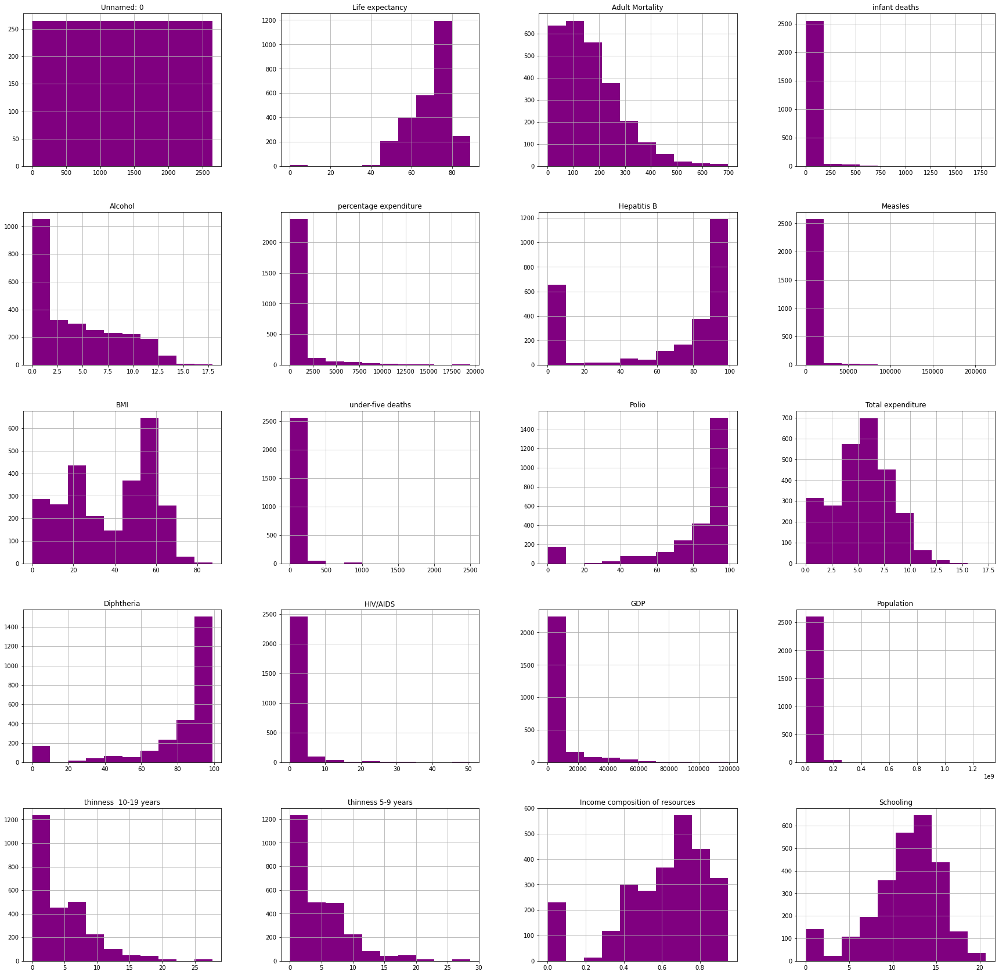

In [7]:
datos.hist(figsize=(30,30), color="purple")
plt.show()

Lo primero que vemos es que la variable ```Unnamed: 0``` es una distribución uniforme. De la misma forma, hay muchas variables que tienen valores en 0 que no deberían estar así y que, de acuerdo con nuestro entendimiento del negocio, eran valores nulos que simplemente fueron puestas en 0. Creemos que esto sucedió para variables como:
* **Life_expectancy:** Es imposible que la expectativa de vida en un país sea 0.
* **Adult Mortality:** Es imposible que haya un país donde no se muerav por lo menos un solo adulto, entre 15 y 60 años.
* **infant deaths:** Es imposible (y de acuerdo con expertos que consultamos para el desarrollo de este laboratorio) que no haya por lo menos 1 niño que muera en un país.
* **under-five deaths:** Mismo problema que infant deaths.
* **percentage_expenditure:** es imposible que un país no invierta al menos un pequeño porcentaje en salud. Vemos que este es el valor más común para dicha columna y, por tanto, podría no ser relevante para el análisis.
* **BMI:** Es imposible que la población tenga un índice de masa corporal de 0. Estos datos también deben estar equivocados.
* **Total expenditure:** tiene el mismo problema que percentage_expenditure. En este caso, no obstante, los valores en 0 son muchos menos.
* **GDP:** Es imposible que el PIB (GDP) de un país sea 0. Seguramente también son datos ausentes.
* **Population:** De nuevo, es imposible que sea 0, si asumimos que estos ceros son valores ausentes, hay muchos valores ausentes (540 - que corresponde al 20.4% de todos los datos de la columna -) entonces, quizá podría resultar conveniente eliminar esta columna. Estas decisiones las tomaremos más adelante.

Veamos algunos ejemplos de variables donde los valores con 0 pueden ser outliers o un problema para el análisis.

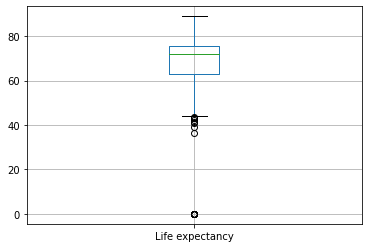

In [8]:
datos.boxplot("Life expectancy")
plt.show()

En el caso particular de expectativa de vida, vemos que los valores en 0 definitivamente son outliers.

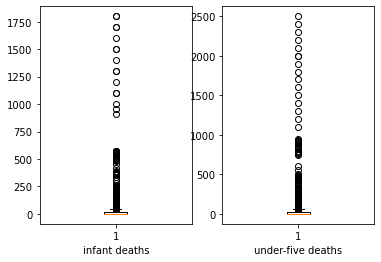

In [9]:
fig, axs = plt.subplots(1,2)
axs[0].boxplot(datos['infant deaths'])
axs[0].set_xlabel('infant deaths')
axs[1].boxplot(datos['under-five deaths'])
axs[1].set_xlabel('under-five deaths')
plt.show()

Como la mayor parte de los datos de variables como infant deaths y under-five deaths son 0, el hecho de quitar dichos valores puede mejorar en gran medida el hecho de que los otros valores sean outliers. No obstante, en este caso los valores con 0 son muchísimos. En dicho caso, podría ser más conveniente eliminar dichos valores.

Es importante anotar que, debido a que el cliente nos dio un conjunto de datos de test para probar el algoritmo, podemos utilizar todos los datos para la construcción del modelo.

Asimismo, identificamos la variable objetivo. En este caso, será: Life expectancy, pues es lo que buscamos predecir. Así,

In [10]:
y = datos["Life expectancy"]
X = datos.drop(['Life expectancy'], axis=1)

## 2. Identificación (preliminar) de variables a utilizar
Antes de realizar el procesamiento de los datos y definir ahí, con mayor claridad, dados los supuestos e inconsistencias de los datos, cuáles son las variables que deben ser utilizadas en los modelos planteados, es posible decir de forma preliminar que la variable Unnamed: 0 puede ser eliminada.

Por la cantidad de ceros que presentan, podría pensarse en eliminar también las variables infant-deaths, under-five deaths, GDP y Population, por ejemplo. No obstante, esto deberá ser analizado más adelante.

En la próxima sección, identificamos los problemas de consistencia o ruido que puedan tener las variables, así como el preprocesamiento necesario para el uso de regresiones lineales.

## 3 Preparación de datos:
En esta etapa, deben identificarse y solucionarse cualquier problema de inconsistencia o ruido que se pueda tener en los datos. Además, deben tenerse en cuenta el preprocesamiento necesario para el uso de regresiones. Es importante ejecutar un esquema de manejo de variables faltantes, identificación/manejo de datos atípicos y de normalizar en caso de ser necesario. Claramente, la regresión lineal requiere que los datos estén escalados. Entonces, de acuerdo con la literatura y las investigaciones, vimos que el mejor escalador en la mayoría de casos era el estandarizador. Este es el que usaremos para este modelo.

En este caso, definiremos dos pipelines para seguir nuestro preprocesamiento. Aunque compartirán algunas cosas en común, una de las pipelines hará la selección de features de forma manual (i.e. con nuestro conocimiento sobre correlaciones) y, la otra, usará el módulo de ```Feature Selection```de scikit learn.
Veamos, entonces, cómo haremos el preprocesamiento.

Lo primero que hacemos es implementar una funcionalidad para eliminar columnas. Esta servirá tanto para ```Unnamed: 0```, la cual dijimos desde el inicio que íbamos a eliminar, como para las otras columnas que decidamos eliminar más adelante en el análisis. Así:

### Nota:
Note que esta es una transformación personalizada al pipeline realizado.

In [11]:
"""
class columnDropperTransformer():
    def __init__(self,columns):
        self.columns=columns

    def transform(self,X,y=None):
        return X.drop(self.columns,axis=1)

    def fit(self, X, y=None):
        return self 
"""

'\nclass columnDropperTransformer():\n    def __init__(self,columns):\n        self.columns=columns\n\n    def transform(self,X,y=None):\n        return X.drop(self.columns,axis=1)\n\n    def fit(self, X, y=None):\n        return self \n'

Este transformador lo usaremos más adelante cuando se decidan todas las variables a eliminar, dependiendo de la pipeline.

### Revisión de rangos

Como vimos en la seccion de perfilamiento de datos, hay variables que tienen una gran cantidad de ceros que no tienen sentido según la definición de la variable. Estas columnas son: Life expectancy, BMI, Adult Mortality, infant deaths, under-five deaths, percentage_expenditure, Total expenditure, GDP, Population. Asumimos que estos ceros corresponden a valores nulos, por lo que procedemos a hacer esta conversión. Para ello, planteamos un transformador.

### Nota:
Note que esta es una transformación personalizada al pipeline realizado.

#### Conversion de ceros a NaN. 

In [12]:
"""
class columnZeroToNaNTransformer():
    def __init__(self,columns):
        self.columns=columns
    def transform(self,X,y=None):
        X[self.columns] = X[self.columns].replace({0:np.nan,0.0:np.nan})
        return X
    def fit(self, X, y=None):
        return self
"""

'\nclass columnZeroToNaNTransformer():\n    def __init__(self,columns):\n        self.columns=columns\n    def transform(self,X,y=None):\n        X[self.columns] = X[self.columns].replace({0:np.nan,0.0:np.nan})\n        return X\n    def fit(self, X, y=None):\n        return self\n'

### Revisión de valores fuera de rango 

Sabemos por la seccion anterior que las variables fuera de rango son:
* infant deaths  
* Measles
* under-five deaths
* Population
* BMI
* GDP

Comenzaremos con la variable infant deaths, por el diccionario sabemos que indica el Número de infantes que mueren por cada 1000 habitantes. 
Sabemos que el máximo valor que puede tomar esta variable es mil, por lo que miraremos cuantos datos se salen de este máximo.

#### Variable infant deaths:

In [13]:
fuera_rango_infant_deaths=len(datos[datos["infant deaths"]>1000]) + len(datos[datos["infant deaths"]==0])
porcentaje= fuera_rango_infant_deaths/datos.shape[0] *100
print('Hay : {}'.format(fuera_rango_infant_deaths), "datos fuera del rango, lo cual representa el {:.2f}%".format(porcentaje), "de datos.")   

Hay : 816 datos fuera del rango, lo cual representa el 30.86% de datos.


#### Variable Measles

Para la variable Measles pasa igual que la anterior variable, pues hay datos que se pasan de mil. Revisaremos cuantos datos se pasan de mil

In [14]:
fuera_rango_Measles=len(datos[datos["Measles"]>1000])
porcentaje= fuera_rango_Measles/datos.shape[0] *100
print('Hay : {}'.format(fuera_rango_Measles), "datos fuera del rango, lo cual representa el {:.2f}%".format(porcentaje), "de datos.")   

Hay : 459 datos fuera del rango, lo cual representa el 17.36% de datos.


#### Variable under-five deaths

Para la variable under-five deaths pasa igual que la anterior variable, pues hay datos que se pasan de mil. Revisaremos cuantos datos se pasan de mil

In [15]:
fuera_rango_under_five_deaths=len(datos[datos["under-five deaths"]>1000]) + len(datos[datos["under-five deaths"]==0])
porcentaje= fuera_rango_under_five_deaths/datos.shape[0] *100
print('Hay : {}'.format(fuera_rango_under_five_deaths), "datos fuera del rango, lo cual representa el {:.2f}%".format(porcentaje), "de datos.")   

Hay : 763 datos fuera del rango, lo cual representa el 28.86% de datos.


#### Variable BMI

Continuaremos con la variable BMI, por el perfilamiento sabemos que esta comprende un rango entre 0 y 87.3. Sin embargo, al investigar cuales valores tienen sentido para esta variable, encontramos que se debe tener un rango entre 10 y 60, por lo que ese será el rango que revisameremos en este punto. 

In [16]:
fuera_rango_BMI=len(datos[datos["BMI"]>60])+len(datos[datos["BMI"]<10])
porcentaje= fuera_rango_BMI/datos.shape[0] *100
print('Hay : {}'.format(fuera_rango_BMI), "datos fuera del rango, lo cual representa el {:.2f}%".format(porcentaje), "de datos.")   

Hay : 589 datos fuera del rango, lo cual representa el 22.28% de datos.


#### Variable GDP

Como vimos en el perfilaminto, esta variable tiene datos con cero, lo cual no encontramos lógico según el sentido que tiene esta variable. Investigando, encontramos que el pais con menor GDP es de 200, asi que revisaremos cuantos valores son  inferiores a este número.

In [17]:
fuera_rango_GDP=len(datos[datos["GDP"]<200])
porcentaje= fuera_rango_GDP/datos.shape[0] *100
print('Hay : {}'.format(fuera_rango_GDP), "datos fuera del rango, lo cual representa el {:.2f}%".format(porcentaje), "de datos.")   

Hay : 632 datos fuera del rango, lo cual representa el 23.90% de datos.


#### Variable Population

Verificando que el país con menos habitantes tiene 800 personas, vemos cuántos datos así hay en nuestro dataset:

In [18]:
fuera_rango_Population=len(datos[datos["Population"]<800])
porcentaje= fuera_rango_Population/datos.shape[0] *100
print('Hay : {}'.format(fuera_rango_Population), "datos fuera del rango, lo cual representa el {:.2f}%".format(porcentaje), "de datos.")   

Hay : 569 datos fuera del rango, lo cual representa el 21.52% de datos.


#### Variable total expenditure

Todos los países gastan en salud, entonces debe ser mayor a 0:

In [19]:
fuera_rango_total_expenditure=len(datos[datos["Total expenditure"]==0])
porcentaje= fuera_rango_total_expenditure/datos.shape[0] *100
print('Hay : {}'.format(fuera_rango_total_expenditure), "datos fuera del rango, lo cual representa el {:.2f}%".format(porcentaje), "de datos.")   

Hay : 208 datos fuera del rango, lo cual representa el 7.87% de datos.


#### Variable percentage expenditure

Analizaremos esta variable teniendo en cuenta que esta representa un porcentaje, el cual comprende de 0 a 100, sin incluir el 0 ni el 100.

In [20]:
fuera_rango_percentage_expenditure=len(datos[datos["percentage expenditure"]<100]) + len(datos[datos["percentage expenditure"]==0])
porcentaje= fuera_rango_percentage_expenditure/datos.shape[0] *100
print('Hay : {}'.format(fuera_rango_percentage_expenditure), "datos fuera del rango, lo cual representa el {:.2f}%".format(porcentaje), "de datos.")   

Hay : 1941 datos fuera del rango, lo cual representa el 73.41% de datos.


Como observamos en el perfilamiento, esta variable tiene alrededor de un 73.41% de datos no válidos, es decir, mayores a 100 0 iguales 0, ya que la variable corresponde a un porcentaje y no tiene sentido que haya gasto de 0, respectivamente. Igualmente, en el Pandas Profiling podemos observar que esta variable tiene una alta correlación con la variable GDP. Por estas dos razones anteriores, concluimos que la variable puede ser eliminada sin alterar el desempeño del modelo que vamos a crear.

Todas las otras variables tienen un porcentaje menor de valores fuera de rango. Por lo tanto, lo que podemos hacer es volver dichos valores fuera de rango en NaN y, posteriormente, hacer una imputación de ellos con la media. Esto se puede hacer sobre TODAS las variables, excepción hecha de Life expectancy, que es la variable objetivo. Los valores en 0 de esta variable deben ser eliminados. Así,

In [21]:
"""
class outOfRangeTransformer():
    def __init__(self):
        pass
    def transform(self,X,y=None):
        X["infant deaths"] = X["infant deaths"].apply( lambda x : x if x<=1000 else np.nan)
        X["Measles"] = X["Measles"].apply( lambda x : x if x<=1000 else np.nan )
        X["under-five deaths"] = X["under-five deaths"].apply( lambda x : x if x<=1000 else np.nan )
        X["BMI"] = X["BMI"].apply( lambda x : x if (x<=60 and x>=10) else np.nan )
        X["GDP"] = X["GDP"].apply( lambda x : x if x>=200 else np.nan )
        X["Population"] = X["Population"].apply( lambda x : x if x>=800 else np.nan )
        X["Total expenditure"] = X["Total expenditure"].apply( lambda x : x if x>0 else np.nan )
        X = X.fillna(datos.mean())
        return X
    def fit(self, X, y=None):
        return self
"""

'\nclass outOfRangeTransformer():\n    def __init__(self):\n        pass\n    def transform(self,X,y=None):\n        X["infant deaths"] = X["infant deaths"].apply( lambda x : x if x<=1000 else np.nan)\n        X["Measles"] = X["Measles"].apply( lambda x : x if x<=1000 else np.nan )\n        X["under-five deaths"] = X["under-five deaths"].apply( lambda x : x if x<=1000 else np.nan )\n        X["BMI"] = X["BMI"].apply( lambda x : x if (x<=60 and x>=10) else np.nan )\n        X["GDP"] = X["GDP"].apply( lambda x : x if x>=200 else np.nan )\n        X["Population"] = X["Population"].apply( lambda x : x if x>=800 else np.nan )\n        X["Total expenditure"] = X["Total expenditure"].apply( lambda x : x if x>0 else np.nan )\n        X = X.fillna(datos.mean())\n        return X\n    def fit(self, X, y=None):\n        return self\n'

### Nota:
Note que esta es una transformación personalizada al pipeline realizado.

Este transformador, además, devuelve las variables explicativas (X) y la objetivo en dos instancias separadas.

Creamos la pipeline que nos dio el mejor modelo en el laboratorio pasado, usando una selección manual de columnas. Pero, antes de eso, definimos las partes de preprocesamiento:

In [30]:
cols_zero_to_nan = ['BMI', 'Adult Mortality', 'infant deaths', 'under-five deaths', 'Total expenditure', 'GDP', 'Population']
new_cols = ['BMI', 'Adult Mortality', 'infant deaths', 'under-five deaths', 'Total expenditure', 'GDP', 'Population', 'Measles']


preproc = [
    ("columnDropper", columnDropperTransformer(['Unnamed: 0','percentage expenditure'])),
    ("zeroToNan", columnZeroToNaNTransformer(cols_zero_to_nan)),
    ("outOfRange", outOfRangeTransformer(new_cols))
]

['BMI', 'Adult Mortality', 'infant deaths', 'under-five deaths', 'Total expenditure', 'GDP', 'Population']


In [31]:
pipe_manual  = Pipeline(preproc)

Podemos verificar que las funciones se hayan aplicado adecuadamente:

In [32]:
datos_t = pipe_manual.fit_transform(datos, datos['Life expectancy'])
datos_t.head(5)

,Life expectancy,Adult Mortality,infant deaths,Alcohol,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 10-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,65.0,263.0,62.0,0.01,65.0,85.432494,19.1,83.0,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,59.9,271.0,64.0,0.01,62.0,492.000000,18.6,86.0,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,59.9,268.0,66.0,0.01,64.0,430.000000,18.1,89.0,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,59.5,272.0,69.0,0.01,67.0,85.432494,17.6,93.0,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,59.2,275.0,71.0,0.01,68.0,85.432494,17.2,97.0,68.0,7.87,68.0,0.1,8825.615395,2978599.0,18.2,18.2,0.454,9.5


Verificamos entonces que no haya nulos:

In [33]:
datos_t.isnull().sum(axis = 0)

Life expectancy                    0
Adult Mortality                    0
infant deaths                      0
Alcohol                            0
Hepatitis B                        0
Measles                            0
BMI                                0
under-five deaths                  0
Polio                              0
Total expenditure                  0
Diphtheria                         0
HIV/AIDS                           0
GDP                                0
Population                         0
thinness  10-19 years              0
thinness 5-9 years                 0
Income composition of resources    0
Schooling                          0
dtype: int64

## 2. Identificación de variables a utilizar  
Debemos identificar las variables más relevantes para el modelo de regresión lineal. Lo haremos de dos formas: "manualmente" o usando las técnicas de selección de features de scikit-learn. Hagamos primero la investigación para el caso manual.

### 2.1 Búsqueda de relaciones entre variables (diagramas de dispersión)

Para realizar esta seccion, primero identificaremos nuestra variable objetivo, la cual será **Life expectancy** y veremos la relacion de las demas variables con esta. 

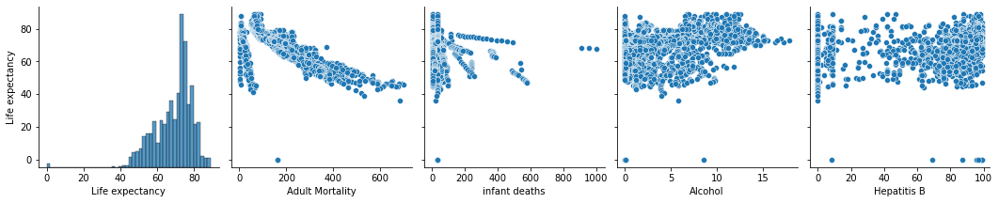

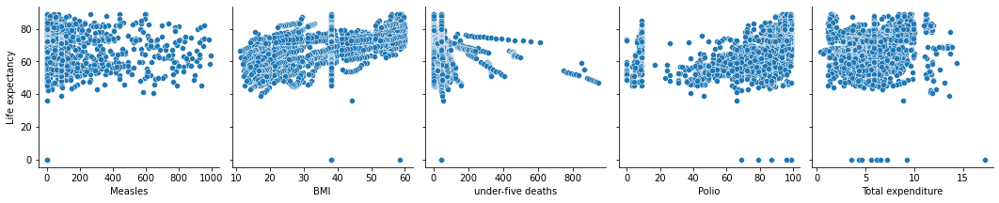

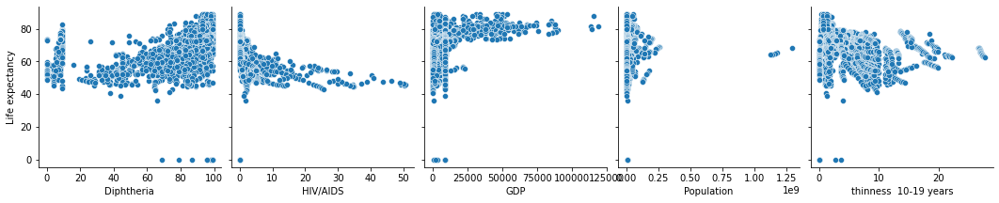

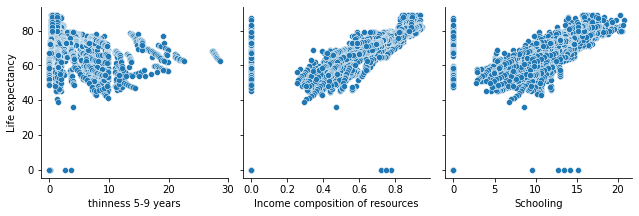

In [34]:
#datos = X.assign(Life_expectancy = y)
sns.pairplot(datos_t, height=3, y_vars = 'Life expectancy', x_vars = datos_t.columns[0:5], kind='scatter')
sns.pairplot(datos_t, height=3, y_vars = 'Life expectancy', x_vars = datos_t.columns[5:10], kind='scatter')
sns.pairplot(datos_t, height=3, y_vars = 'Life expectancy', x_vars = datos_t.columns[10:15], kind='scatter')
sns.pairplot(datos_t, height=3, y_vars = 'Life expectancy', x_vars = datos_t.columns[15:], kind='scatter')
plt.show()

Con estos gráficos podemos encontrar que las variables que **no** parecen tener una relación con la variable de interés son :
* Alcohol
* Hepatitis B
* Measles
* Total expenditure
* Population

Y otras más. No obstante, para decidir adecuadamente, es necesario tener en cuenta la matriz de correlación.

Revisaremos la matriz de correlacion para asegurarnos de esta afirmación

 ### Búsqueda de relaciones entre variables (Matriz de correlaciones)

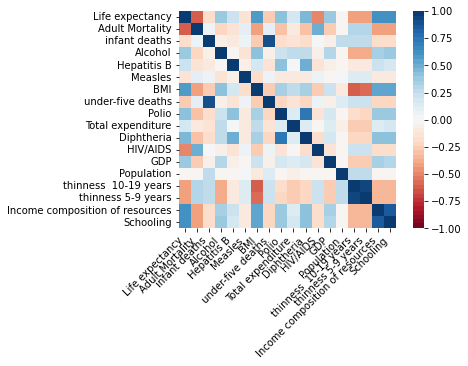

In [35]:
corr = datos_t.corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.color_palette("RdBu",50),
    square=True,
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

De esta matriz de correlacion podemos destacar que hay variables que estan relacionadas entre ellas. Algunas destacables son:
* under-five deaths con infant deaths
* Scholing con Income composition of resources
* Life expentancy con Adult Mortality (inversamente relacionadas)
* BMI con thinness  10-19 years y thinness 5-9 years

Para asegurarnos de que estos valores estan altamente relacionados, revisaremos sus coeficientes de correlación

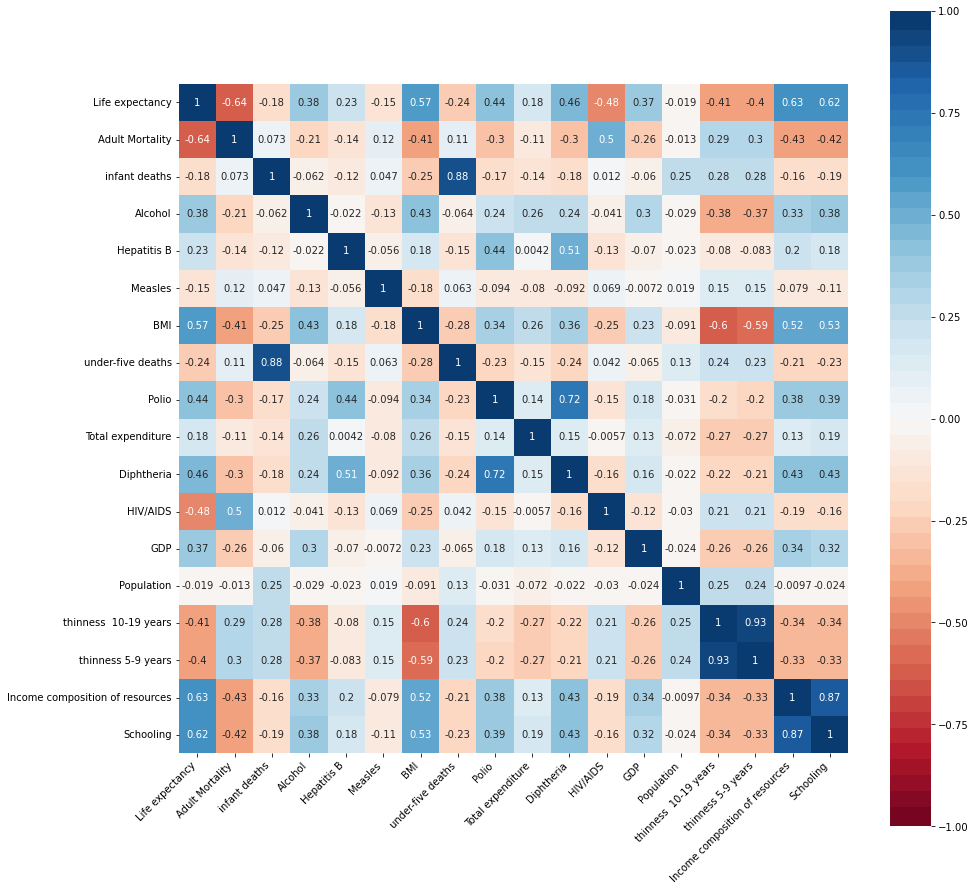

In [36]:
plt.figure(figsize =(15,15))
corr = datos_t.corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.color_palette("RdBu",50),
    square=True,
    annot = True
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

Utilizando Python:

In [37]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

def get_top_abs_correlations(df, n):
    au_corr = df.corr().unstack()
    labels_to_drop = get_redundant_pairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[0:n], au_corr[-n:]
corrs_pos, corrs_neg = get_top_abs_correlations(df=datos_t, n=10)[0], get_top_abs_correlations(df=datos_t, n=10)[1]

Las correlaciones positivas más fuertes son:

In [38]:
corrs_pos

thinness  10-19 years            thinness 5-9 years                 0.934581
infant deaths                    under-five deaths                  0.880809
Income composition of resources  Schooling                          0.867713
Polio                            Diphtheria                         0.720398
Life expectancy                  Income composition of resources    0.633085
                                 Schooling                          0.621892
                                 BMI                                0.573272
BMI                              Schooling                          0.534859
                                 Income composition of resources    0.521162
Hepatitis B                      Diphtheria                         0.506594
dtype: float64

Las correlaciones negativas más fuertes son:

In [39]:
corrs_neg

Alcohol          thinness  10-19 years             -0.381337
Life expectancy  thinness 5-9 years                -0.403558
                 thinness  10-19 years             -0.407822
Adult Mortality  BMI                               -0.413789
                 Schooling                         -0.420993
                 Income composition of resources   -0.432436
Life expectancy  HIV/AIDS                          -0.478195
BMI              thinness 5-9 years                -0.593721
                 thinness  10-19 years             -0.602023
Life expectancy  Adult Mortality                   -0.639812
dtype: float64

Con esto, podemos ver que las variables con alta correlacion(>0.6 o <-0.6) entre ellas y que no tienen que ver con la variable de interés son: 
* thinness  10-19 years y thinness 5-9 years (con 0.93)
* under-five deaths y infant deaths (con 0.8)
* Income composition of resources y Schooling (con 0.87)
* Polio y Diphtheria (con 0.72)
* Income composition of resources y Life_expectancy   (con 0.66)
* Schooling y Life_expectancy (con 0.65)
* BMI y Life_expectancy (con 0.62)

Por el lado de las negativas:
* Adult mortality con life expectancy (con -0.7)
* BMI con thinness  10-19 years (con -0.6)




Ahora, respecto a las correlaciones entre la variable de interés (Life expectancy) y las demás, podemos ver que las que tienen una correlación muy pequeña positiva o negativa, de acuerdo con la definición de coeficientes de correlación, (entre -0.21 y 0.21) son :
* infant deaths
* Total expenditure 
* Population

Podemos ver que la variable Alcohol y Hepatitis B si tienen una relación con la variable de interés (contrario a lo que habíamos intuido con los diagramas de dispersión)



Despues de estos 2 análisis, escojeremos todas las variables excepto **infant deaths**, **Total expenditure** y **Population** por su baja correlación con la variable Life expectancy. Adicional a esto, para las variables que estan correlacionadas entre ellas se escojerá solo una de ellas. El criterio de decisión será la que tenga la correlacion mas signitiva (mas positiva o mas negativa) con la variable de interés. En caso de que sea el mismo valor, se escoje cualquiera. Al aplicar esto, obtenemos:

* thinness 10-19 years y thinness 5-9 years -> nos quedamos con: **thinness 10-19 years**
* BMI con thinness 10-19 years-> Nos quedamos con **BMI**

Pero BMI y thinness 10-19 years tienen una correlación negativa: **no podemos quedarnos con ambas**. Tomamos **BMI, que está más correlacionada con Life Expectancy** que thinness 10-19 years. Esta es, entonces, descartada.

* Income composition of resources y Schooling -> **Income composition of resources**
* Polio y Diphtheria -> nos quedamos con:**Diphtheria**


Esto ultimo se realiza con el fin de evitar colinealidad.
Nota: Al final no tomaremos la variable thinness 10-19 year, porque esta tambien está correlacionada con BMI y BMI, en comparación, SÍ tiene una correlación mayor con la variable de interés. En este caso, las variables que nos quedan para usar son, entonces:

In [40]:
# Se usa un transformador para seleccionar unicamente las columnas que se quieren usar
selected_cols = ['Adult Mortality', 'Alcohol','Hepatitis B', 'BMI', 'under-five deaths', 
       'Diphtheria', 'HIV/AIDS', 'GDP','Income composition of resources', 'Measles']

## 4. Modelamiento:
A partir de las variables identificadas anteriormente, se debe plantear una regresión que estime la variable objetivo y medir su desempeño.


### Modelo 1: 
Sobre las variables que nosotros detectamos. En este caso, elegimos las columnas definidas por nosotros y, después, aplicamos el escalador estándar. De acuerdo con la literatura, es el mejor para la regresión lineal.

In [41]:
#Debido a que el algoritmo que usaremos para la construcción del modelo es Regresión Linear, 
#debemos realizar escalamiento de los datos, por lo que procedemos con lo siguiente
pipe_manual.steps.append(('initial',ColumnTransformer([("selector", 'passthrough', selected_cols)])))
pipe_manual.steps.append(('scaler', StandardScaler()))                                 
                                   

# Modelo
pipe_manual.steps.append(('model', LinearRegression()))


In [42]:
pipe_manual

Pipeline(steps=[('columnDropper',
                 <clases.columnDropperTransformer object at 0x7fc6ef53ee20>),
                ('zeroToNan',
                 <clases.columnZeroToNaNTransformer object at 0x7fc6ef53eb20>),
                ('outOfRange',
                 <clases.outOfRangeTransformer object at 0x7fc6ef53ec70>),
                ('initial',
                 ColumnTransformer(transformers=[('selector', 'passthrough',
                                                  ['Adult Mortality', 'Alcohol',
                                                   'Hepatitis B', 'BMI',
                                                   'under-five deaths',
                                                   'Diphtheria', 'HIV/AIDS',
                                                   'GDP',
                                                   'Income composition of '
                                                   'resources',
                                                   'Measles'])])),

Separamos de nuevo las variables explicativas (X) de la objetivo (y):

In [43]:
X = datos.drop('Life expectancy', axis = 1)
y = datos['Life expectancy']

In [44]:
p1 = pipe_manual.fit(X,y)

Ahora, revisaremos cuales son las variables significativas del modelo, para saber si debemos realizar otro. Para esto, realizaremos la prueba t-test 

La prueba t de Student o t-test, con las siguientes hipótesis sobre los coeficientes, indica que:

H0: wi = 0, es decir, no hay una relación lineal entre la variable dependiente y la independiente (hipótesis nula).

Ha: wi ≠ 0, es decir, sí existe una relación lineal entre ambas variables.

El p-valor (en inglés p-value) del coeficiente verifica entonces la hipótesis nula de la siguiente forma:
Si el p-valor es menor o igual que el nivel de significancia seleccionado, entonces se puede afirmar que los datos suministran suficiente evidencia para rechazar la hipótesis nula. Es decir, cambios en la variable independiente estarán asociados con cambios en la variable dependiente y esta relación es estadísticamente significativa, por lo que la variable independiente será importante para el modelo de regresión.
Si el p-valor es mayor que el nivel de significancia, entonces no hay suficiente evidencia en los datos para rechazar la hipótesis nula y concluir que w1 es significativamente diferente de 0.

Por otra parte, el valor de un coeficiente determina cuánto aumenta o se reduce el valor promedio de la variable dependiente cuando la independiente cambia por una unidad. El signo del coeficiente indica si la relación es positiva o negativa.


Podemos sacar un reporte que nos va a permitir analizar estadísticos del modelo. En este caso, exigimos p-value = 0.1. Tal que rechazamos todas aquellas variables cuyo p-value sea mayor a dicho valor.

In [45]:
# Ajustar el modelo para ver el reporte
x=datos[selected_cols]
model = sm.OLS(y, x).fit() ## sm.OLS(output, input)
# Mostrar las estadísticas del modelo
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:        Life expectancy   R-squared (uncentered):                   0.967
Model:                            OLS   Adj. R-squared (uncentered):              0.966
Method:                 Least Squares   F-statistic:                              7612.
Date:                Sun, 01 May 2022   Prob (F-statistic):                        0.00
Time:                        19:25:08   Log-Likelihood:                         -10487.
No. Observations:                2644   AIC:                                  2.099e+04
Df Residuals:                    2634   BIC:                                  2.105e+04
Df Model:                          10                                                  
Covariance Type:            nonrobust                                                  
===================================================================================================
                                      coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
Adult Mortality                     0.0525      0.002     24.466      0.000       0.048       0.057
Alcohol                             0.2988      0.068      4.426      0.000       0.166       0.431
Hepatitis B                         0.0032      0.008      0.417      0.677      -0.012       0.018
BMI                                 0.2264      0.015     15.570      0.000       0.198       0.255
under-five deaths                   0.0085      0.002      4.884      0.000       0.005       0.012
Diphtheria                          0.3513      0.011     30.939      0.000       0.329       0.374
HIV/AIDS                           -0.7046      0.060    -11.743      0.000      -0.822      -0.587
GDP                              1.852e-05   2.08e-05      0.891      0.373   -2.23e-05    5.93e-05
Income composition of resources    32.9095      1.271     25.897      0.000      30.418      35.401
Measles                             0.0001   2.44e-05      5.608      0.000    8.91e-05       0.000
==============================================================================
Omnibus:                      367.189   Durbin-Watson:                   0.882
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1432.690
Skew:                           0.641   Prob(JB):                    7.86e-312
Kurtosis:                       6.370   Cond. No.                     7.88e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 7.88e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Según la prueba obtenida, con una confianza del 90%, ni la variable Hepatitis B ni GDP son significativas, por lo que, para esta variable se acepta la hipótesis nula.
Por lo anterior, realizaremos otro modelo, quitando dichas variables.

### Modelo 2 - Elegido de acuerdo con los resultados del laboratorio 3

In [58]:
# Agregamos las fases de preprocesamiento
preproc = [
    ("columnDropper", columnDropperTransformer(['Unnamed: 0','percentage expenditure'])),
    ("zeroToNan", columnZeroToNaNTransformer(cols_zero_to_nan)),
    ("outOfRange", outOfRangeTransformer(new_cols)),
]
pipe_elegida = Pipeline(preproc)

In [59]:
pipe_elegida

Pipeline(steps=[('columnDropper',
                 <clases.columnDropperTransformer object at 0x7fc6d18863d0>),
                ('zeroToNan',
                 <clases.columnZeroToNaNTransformer object at 0x7fc6d1886730>),
                ('outOfRange',
                 <clases.outOfRangeTransformer object at 0x7fc6d1886bb0>)])

In [60]:
# Elegimos las nuevas columnas - otro transformador manual y aplicamos los transformadores
selected_cols_2 = ['Adult Mortality', 'Alcohol', 'BMI', 'under-five deaths', 
       'Diphtheria', 'HIV/AIDS','Income composition of resources']

pipe_elegida.steps.append(('initial',ColumnTransformer([("selector", 'passthrough',selected_cols_2)])))
pipe_elegida.steps.append(('scaler', StandardScaler()))                                 
                                   

# Agregamos el modelo a la pipeline
pipe_elegida.steps.append(('model', LinearRegression()))

In [61]:
pipe_elegida

Pipeline(steps=[('columnDropper',
                 <clases.columnDropperTransformer object at 0x7fc6d18863d0>),
                ('zeroToNan',
                 <clases.columnZeroToNaNTransformer object at 0x7fc6d1886730>),
                ('outOfRange',
                 <clases.outOfRangeTransformer object at 0x7fc6d1886bb0>),
                ('initial',
                 ColumnTransformer(transformers=[('selector', 'passthrough',
                                                  ['Adult Mortality', 'Alcohol',
                                                   'BMI', 'under-five deaths',
                                                   'Diphtheria', 'HIV/AIDS',
                                                   'Income composition of '
                                                   'resources'])])),
                ('scaler', StandardScaler()), ('model', LinearRegression())])

In [62]:
p2 = pipe_elegida.fit(X,y)

#### prueba t-student

In [63]:
# Ajustar el modelo para ver el reporte
x=datos[selected_cols_2]
model = sm.OLS(y, x).fit() ## sm.OLS(output, input)
# Mostrar las estadísticas del modelo
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:        Life expectancy   R-squared (uncentered):                   0.966
Model:                            OLS   Adj. R-squared (uncentered):              0.966
Method:                 Least Squares   F-statistic:                          1.075e+04
Date:                Sun, 01 May 2022   Prob (F-statistic):                        0.00
Time:                        19:25:40   Log-Likelihood:                         -10503.
No. Observations:                2644   AIC:                                  2.102e+04
Df Residuals:                    2637   BIC:                                  2.106e+04
Df Model:                           7                                                  
Covariance Type:            nonrobust                                                  
===================================================================================================
                                      coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
Adult Mortality                     0.0520      0.002     24.503      0.000       0.048       0.056
Alcohol                             0.3187      0.066      4.843      0.000       0.190       0.448
BMI                                 0.2260      0.015     15.498      0.000       0.197       0.255
under-five deaths                   0.0134      0.001      8.972      0.000       0.011       0.016
Diphtheria                          0.3565      0.010     37.442      0.000       0.338       0.375
HIV/AIDS                           -0.6998      0.060    -11.617      0.000      -0.818      -0.582
Income composition of resources    32.9008      1.227     26.804      0.000      30.494      35.308
==============================================================================
Omnibus:                      356.174   Durbin-Watson:                   0.875
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1362.802
Skew:                           0.626   Prob(JB):                    1.18e-296
Kurtosis:                       6.287   Cond. No.                     1.10e+03
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 1.1e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Con estos resultados, se puede decir que, con una significancia del 10%, todas las variables son significativas para la variable de interes, por lo tanto se rechaza la hipótesis nula

## 5.Evaluación cuantitativa:
A partir de las métricas seleccionadas para comparar y seleccionar el mejor modelo, explicamos el resultado obtenido desde el punto de vista cuantitativo. En esta sección se utilizan las siguientes métricas:

1. Root-Mean-Squared-Error(RMSE). Raiz del Error medio cuadrático
2. Mean-Absolute-Error(MAE). Error absoluto medio
3. R² or Coeficiente de determinación.

In [64]:
# Se obtienen las predicciones del modelo sobre el conjunto de entrenamiento.
y_pred1 = p1.predict(X)
y_pred2 = p2.predict(X)

### Coeficiente de Determinación $R^2$

Este valor indica que porcentaje de la varianza en la variable objetivo se puede explicar con las variables observadas. Este se define como:
$$ R^2 =  1 - \frac{\sum_{i=1}^{n} (y_i - f_i)^2}{\sum_{i=1}^{n} (y_i - \hat{y})^2}$$

donde $y_i$ es el elemento $i$ de la varaible objetivo, $f_i$ el elemento i de los valores predecidos y:

$$ \hat{y} = \frac{1}{n} \sum_{i=1}^{n} y_{i} $$


In [65]:
r2_1=r2_score(y, y_pred1)
r2_2= r2_score(y, y_pred2)
print ("Para el modelo 1, el r^2 es de:",r2_1)
print ("Para el modelo 2, el r^2 es de:",r2_2)

Para el modelo 1, el r^2 es de: 0.6727873661268996
Para el modelo 2, el r^2 es de: 0.6639508993780582


Podemos ver que ambos modelos estiman bastante bien a la variable real, ambos modelos explican aproximadamente el 67% de la variable de interés. Por una poca diferencia, el modelo 1 tiene el coeficiente más alto, por lo que explicaría un poco más la variable de interés 

### Root-Mean-Square Error (RMSE) 
La segunda medida es la raiz del error cuadrático medio, definido como:

$$ RSME = \sqrt{\frac{\sum_{i=1}^{n} (y_i - f_i)^2}{n}} $$

In [66]:
# Se obtienen las métricas a partir de la predicción y la base de evaluación (valores reales).
rmse1=mean_squared_error(y, y_pred1, squared=False)
rmse2=mean_squared_error(y, y_pred2, squared=False)

print ("Para el modelo 1, el RMSE es de:",rmse1)
print ("Para el modelo 2, el RMSE es de:",rmse2)

Para el modelo 1, el RMSE es de: 5.920344351351377
Para el modelo 2, el RMSE es de: 5.999752075803981


Podemos que estos resultados son muy parecidos. Sin embargo, evidenciamos que el modelo 1 presenta un RMS menor que el modelo 2, lo cual significa que este tiene un mejor ajuste que el segundo modelo. 

### Mean-Absolute-Error(MAE). 
Error absoluto medio

In [67]:
mae1=mean_absolute_error(y, y_pred1)
mae2=mean_absolute_error(y, y_pred2)


print ("Para el modelo 1, el MAE es de:",mae1)
print ("Para el modelo 2, el MAE es de:",mae2)

Para el modelo 1, el MAE es de: 3.587561547214877
Para el modelo 2, el MAE es de: 3.664709506209716


Para los dos modelos podemos ver que, en promedio la "distancia" del pronóstico de Life expectancy desde el valor verdadero de esta variable es aproximadamente 3.6. Con esto, podemos ver que el modelo 2 representa en promedio una distancia un poco mas larga que el modelo 1. Por lo que nuevamente, el modelo 1 destaca por una diferencia mínima respecto al modelo 2. 

El resumen de los resultados de ambos modelos se puede ver a continuación

In [68]:
data={"MODELO":[1,2],"RMSE":[rmse1, rmse2],"MAE":[mae1, mae2], "R²":[r2_1,r2_2]}
df = pd.DataFrame(data)  
df  

,MODELO,RMSE,MAE,R²
0,1,5.920344,3.587562,0.672787
1,2,5.999752,3.664710,0.663951


Ahora, respondiendo las preguntas planteadas, nuestro equipo sí recomienda instalar el modelo de estimación en producción.
    
Realizamos la comparacion entre los tres modelos y pudimos ver que ambos estimarían bien la variable de interes (Siendo, por muy pocas diferencias, mejor el modelo 1). Sin embargo, debemos tener en cuenta que el modelo 1 tiene una variable extra, lo cual puede hacer que el modelo sea mas complejo que el 2 y que además afecte negativamente los grados de libertad del modelo. Como los cambios entre el modelo 1 y 2 no son muy significativos, y usando los principios estadísticos de la navaja de Ockham, para continuar con la evaluación cualitativa, se escojerá el **modelo 2**.  

Pudimos observar un valor pequeño respecto a los errores (RMSE y MAE) y un gran ajuste al mirar $R^2$. No obstante, un modelo que logre explicar apenas el 66% del cambio en la expectativa de vida, aunque es bueno, es posible implementar modelos más robustos que tengan mejores desempeños. En particular, sugerimos la implementación de modelos como regresiones lineales regularizadas (como Lasso y Ridge, que muchas veces arrojan mejores resultados que la regresión lineal) random forest para regresión (que es un método de ensamble y se espera tenga mejor desempeño), o una red neuronal para regresión. La implementación de estos modelos se sale del enfoque de este laboratorio, pero podría ser de gran importancia para los Alpes.

## 6.Evaluación cualitativa

En esta parte del análisis, nos enfocaremos en determinar cuales fueron las variables más influyentes y más confiables en los resultados. En las anteriores secciones ya realizamos la validación de supuestos pues, justamente uno de los criterios para construir las regresiones manuales fue eliminar las variables que fueran colineales. Asimismo, se eliminaron las variables cuya significancia estadística no era considerable. No obstante, verificaremos que en efecto el modelo 2 no tiene variables colineales.

Lo que viee ahora es, entonces, interpretar los coeficientes de la regresión, identificando los mas relevantes para la tarea y como afectan la variable objetivo.

Por las métricas mostradas anteriormente, se realizará la evaluación cualitativa con el modelo 2. Verificamos que el modelo 3 no es colineal y se descarta.

### Validación de supuestos: 
Realice los ajustes necesarios para que su modelo cumpla con las suposiciones necesarias para la inferencia estadística con regresiones.

#### Colinealidad
Es necesario que las columnas utilizadas no tengan (o tengan muy poca) colinealidad. La forma mas sencilla de hacer esto es con la matriz de correlación

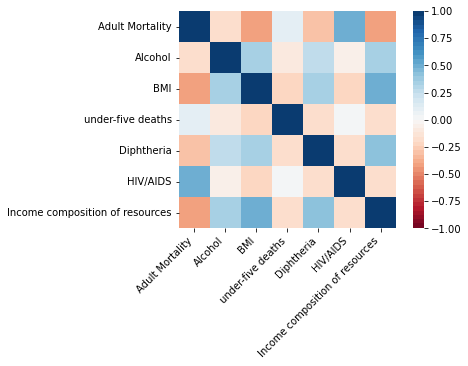

In [69]:
corr = datos[selected_cols_2].corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.color_palette("RdBu",50),
    square=True,
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

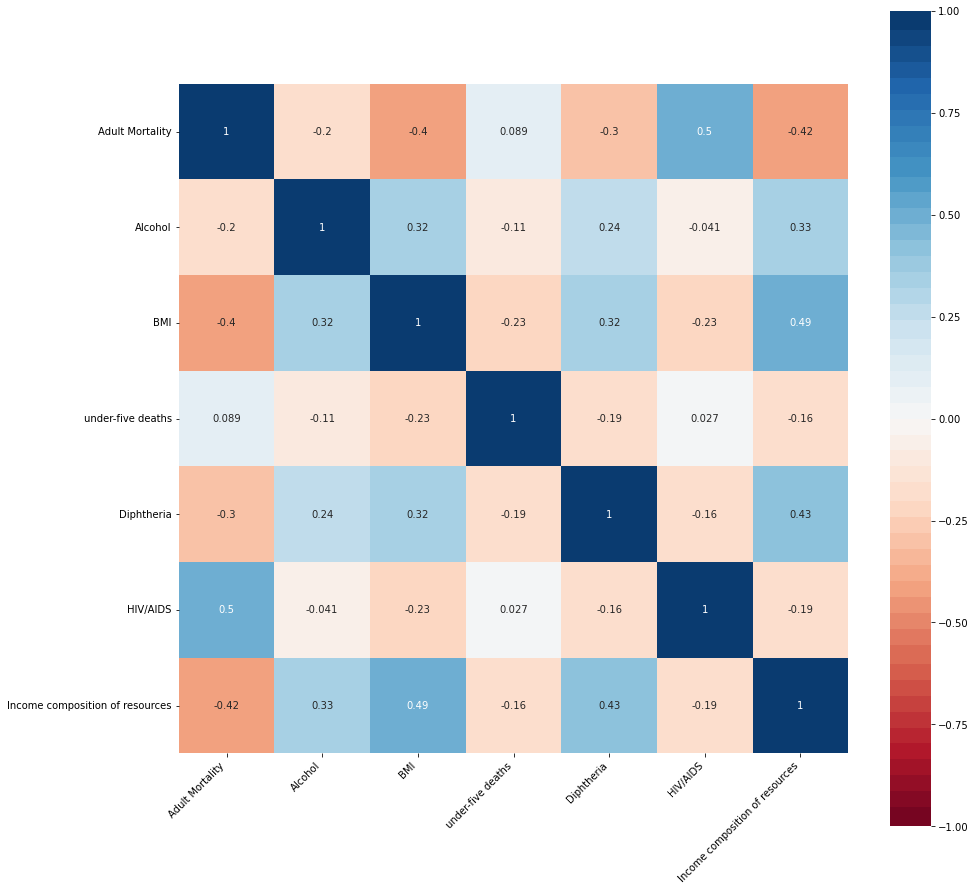

In [70]:
plt.figure(figsize =(15,15))
corr = datos[selected_cols_2].corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.color_palette("RdBu",50),
    square=True,
    annot = True
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

#### Linealidad
Es necesario que la relación entre cada variable explicativa y la varable objetivo sea lineal. Muchas veces la mejor forma de hacer esto es visualmente:

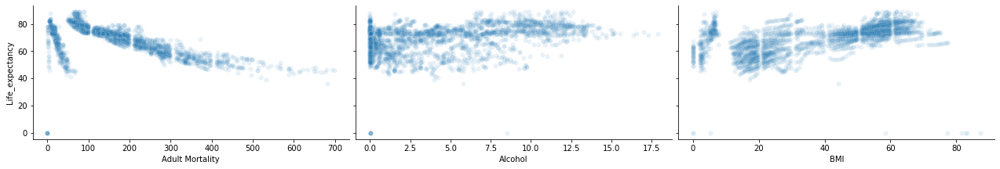

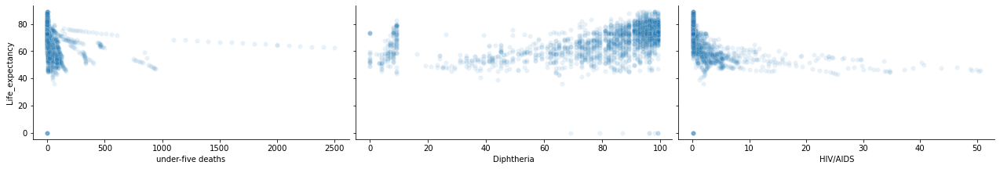

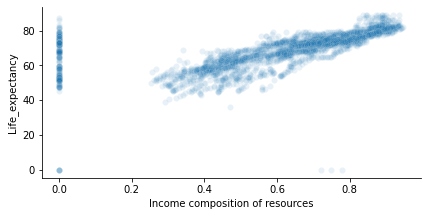

In [71]:
datos_t = X.assign(Life_expectancy = y)

sns.pairplot(datos_t, height=3, aspect = 2, y_vars = 'Life_expectancy', x_vars = selected_cols_2[0:3], kind='scatter', plot_kws = {'alpha':0.1})
sns.pairplot(datos_t, height=3, aspect = 2, y_vars = 'Life_expectancy', x_vars = selected_cols_2[3:6], kind='scatter', plot_kws = {'alpha':0.1})
sns.pairplot(datos_t, height=3, aspect = 2, y_vars = 'Life_expectancy', x_vars = selected_cols_2[6:], kind='scatter', plot_kws = {'alpha':0.1})

Podemos ver que, aunque en algunos casos, la correlación lineal sea algo débil, es evidente que hay una relación lineal entre las variables utilizadas y la objetivo. No obstante, también es cierto que hay otro tipo de modelos que podrían comportarse mejor, por lo que quizá valdría la pena, a futuro, implementar un modelo polinomial, por ejemplo.

In [72]:
X=datos
def linearity_test(model, y, X):
    '''
    Function for visually inspecting the assumption of linearity in a linear regression model.
    It plots observed vs. predicted values and residuals vs. predicted values.
    
    Args:
    * model - fitted OLS model from statsmodels
    * y - observed values
    '''
    fitted_vals = model.predict(X)
    resids = (fitted_vals - y)

    fig, ax = plt.subplots(1,2)
    
    sns.regplot(x=fitted_vals, y=y, lowess=True, ax=ax[0], line_kws={'color': 'red'})
    ax[0].set_title('Observed vs. Predicted Values', fontsize=16)
    ax[0].set(xlabel='Predicted', ylabel='Observed')

    sns.regplot(x=fitted_vals, y=resids, lowess=True, ax=ax[1], line_kws={'color': 'red'})
    ax[1].set_title('Residuals vs. Predicted Values', fontsize=16)
    ax[1].set(xlabel='Predicted', ylabel='Residuals')
    plt.tight_layout()
    
# Nota: esta función se demora un poco en correr.
# La corrimos en otro computador y adjunto está el resultado:

<img src='graf.png' width=50%/>

El resultado deseado es que, con una varianza constante, los puntos se distribuyan simétricamente alrededor de una línea diagonal en el primer gráfico o alrededor de una línea horizontal en el último. 
La observación de un patrón 'arqueado' indica que el modelo comete errores sistemáticos cada vez que hace predicciones inusualmente grandes o pequeñas.

Vemos que, no obstante, en este caso los arcos son relativamente pequeños. Por lo tanto, podemos decir que este supuesto se satisface.

#### Normalidad en los Errores

Otra suposición de la regresión lineal es que los errores tienen una distribución normal. Para esto se puede usar:

* Grafico de dispersión entre los errores y el valor predicto
* Grafico Q-Q

In [73]:
def grafica_normalidad_errores(p2, X, y):
        # Calculamos los errores
    errors = (p2.predict(X) - y).values

    fig, axes = plt.subplots(1, 2, figsize = (12,4))

    # Dispersión
    sns.scatterplot(x = p2.predict(X), y = errors, alpha = 0.1, ax = axes[0])

    # q-q plot
    _ = stats.probplot(errors, dist="norm", plot=axes[1])

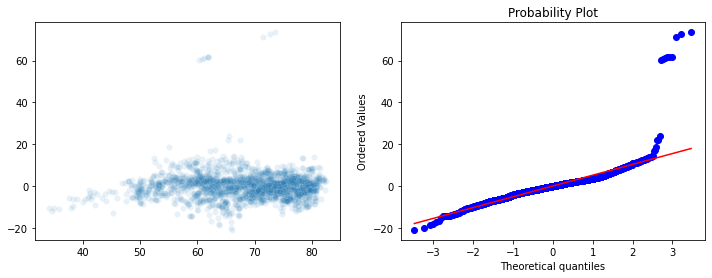

In [74]:
grafica_normalidad_errores(p2, X, y)


En la primera gráfica, se ve que los errores estan centrados en cero, pero no se distribuyen de la misma manera en la gráfica. Por otro lado, al obtener el gráfico Q-Q, podemos decir que al parecer los errores si siguen una distribución normal (media 0 y desviación estandar de 1). Sin embargo, para estar seguros, haremos el histograma de los errores y realizaremos una prueba de normalidad (Kolmogorov–Smirnov)

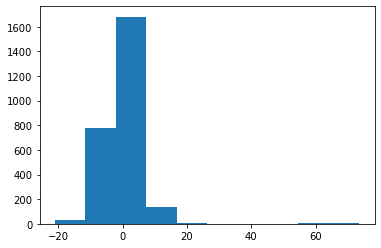

In [75]:
errors= (p2.predict(X) - y).values
plt.hist(errors)
plt.show()

Vemos que los errores están centrados en cero y que, efectivamente parece que tuvieran una distrubución normal. Ahora realizaremos la prueba. 

In [76]:
statistc, pvalue=stats.kstest(errors, "norm")
print ("Estadística", statistc, " p-value", pvalue)
if pvalue<=0.1: print("La hipótesis nula se acepta, sí sigue una distribución normal")
else :print("La hipótesis nula se rechaza")

Estadística 0.30140107242326625  p-value 1.4983924890672165e-213
La hipótesis nula se acepta, sí sigue una distribución normal


Con el análisis realizado previamente, y dado que los errores sí llevan una distribución normal, concluimos que nuestro modelo satisface todos los supuestos.

### Interpretación de los coeficientes
realice una interpretación de los coeficientes de la regresión, identificando los mas relevantes para la tarea y como afectan la variable objetivo.


In [77]:
modelo_regresion=p2["model"]
x=datos[selected_cols_2]
importancia = modelo_regresion.coef_
importancia_atributo = pd.DataFrame(data={"Atributo": x.columns,"Importancia": importancia})
importancia_atributo = importancia_atributo.sort_values(by='Importancia', ascending=False).reset_index(drop=True)
importancia_atributo

,Atributo,Importancia
0,Income composition of resources,3.032021
1,BMI,1.405766
2,Diphtheria,1.251859
3,Alcohol,1.249977
4,under-five deaths,-0.701680
5,HIV/AIDS,-2.275292
6,Adult Mortality,-2.879125


El valor de un coeficiente determina cuánto aumenta o se reduce el valor promedio de la variable dependiente cuando la independiente cambia por una unidad. El signo del coeficiente indica si la relación es positiva o negativa. Daremos un ejemplo para una que tenga coeficiente positivo y otra con coeficiente negativo.  
* Cuando aumenta el income composition of resources (relacionado con el índice de desarrollo humano), aumenta en un año la expectativa de vida. De la misma forma, cuando aumenta el valor de la expectativa de vida en unidad, aumenta el income composition of resources. Esta es la variable que mayor magnitud tiene sobre el modelo.
* Cuando aumenta la vacunación por Diphteria, incrementa la expectativa de vida. De la misma forma, por ejemplo, si aumenta en una unidad la expectativa de vida, aumenta en 1.86 unidades la vacunación por Diphteria.
* Cuando aumenta el valor de la expectativa de vida en unidad, disminuye asimismo el HIV/AIDS en aproximadamente 0.74 unidades.
* Finalmente, cuando aumenta la expectativa de vida en una unidad, disminuye la mortalidad en adultos en 3.28 unidades. Lo cual es interesante, esperaríamos que, quizá, fuera 1 a 1 la relación: aumenta la expectativa de vida, disminuye la mortalidad en adultos en 1 año. No obstante, hay que tener en cuenta aquí la influencia de otras variables como la mortalidad infantil, que se usan en nuestro modelo.

Por último, vemos la distribución de la expectativa de vida en los Alpes:

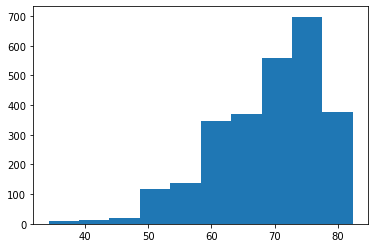

In [78]:
plt.hist(p2.predict(X))
plt.show()

In [79]:
print('Min epxectativa de vida',min(p2.predict(X)))
print('Max expectastiva de vida',max(p2.predict(X)))
print('Edad media de expectativa de vida', np.mean(p2.predict(X)))

Min epxectativa de vida 34.1678505366353
Max expectastiva de vida 82.43348758327213
Edad media de expectativa de vida 69.06879727685326


Vemos que la edad promedio de expectativa de vida se distribuye entre los 506 y los 77 años, con una media de 70 años. Esta no es buena, con respecto a la media mundial, y podría mejorarse con las políticas públicas orientadas sobre las variables con mayor importancia definidas previamente (como el índice de desarrollo humano).

## Exportar el modelo: 
Finalmente, se exporta el modelo para ser desplegado en la API

In [80]:
filename = '../assets/modelo.pkl'
dump(pipe_elegida, filename)

['../assets/modelo.pkl']

In [81]:
df_recent = pd.read_csv('DatosTrain.csv') # Lectura de los datos recientes
# df_recent = pd.read_csv('datos_recientes.csv') # Lectura de los datos recientes
# y_true = pd.read_csv('Recientes_Validacion.csv') # La columna que solo el cliente tiene

In [82]:
with open('../assets/model_pkl', 'wb') as files:
    pickle.dump(pipe_elegida, files)

#### Al correr esto, es importante concatenar los dataframes de df_recent y RecientesValidacion, debido a la forma en la que está construida la pipeline 

In [83]:
# Lee el archivo y carga el modelo
pipeline = load(filename)

In [84]:
# y_true = pd.read_csv('Recientes_Validacion.csv') # La columna que solo el cliente tiene
y_predicted =  pipeline.predict(df_recent)

# Calcula el desempeño del modelo
# np.sqrt(mse(y_true, y_predicted))

Pipeline(steps=[('columnDropper',
                 <clases.columnDropperTransformer object at 0x7fc6ddc577c0>),
                ('zeroToNan',
                 <clases.columnZeroToNaNTransformer object at 0x7fc6ddc57ca0>),
                ('outOfRange',
                 <clases.outOfRangeTransformer object at 0x7fc6ddc57d60>),
                ('initial',
                 ColumnTransformer(transformers=[('selector', 'passthrough',
                                                  ['Adult Mortality', 'Alcohol',
                                                   'BMI', 'under-five deaths',
                                                   'Diphtheria', 'HIV/AIDS',
                                                   'Income composition of '
                                                   'resources'])])),
                ('scaler', StandardScaler()), ('model', LinearRegression())])

In [105]:
datos['Life expectancy'][datos['Unnamed: 0'] == 342]

342    59.2
Name: Life expectancy, dtype: float64

In [123]:
a = pipeline.predict(datos[datos['Unnamed: 0'] == 342])
b = pipeline.predict(datos[datos['Unnamed: 0'] == 2575])
c = [a[0], b[0]]

In [124]:
r2_score(c, [59.2, 73.7])

0.908811542111707

In [125]:
a

array([61.73170627])

In [126]:
b

array([74.94561163])